# Context

Paper published: https://doi.org/10.1016/j.rse.2017.09.039

- **What**? airborne SAR data research campaign for agriculture between 2013 and 2015
- **Motivation**: show changes in backscatter properties during crop growth + bio- and geophysical properties.
- **Acquisition**: between 2013 and 2015 at regular intervals over heterogenously structured agricultural area of Wafferfing near Deggendorf, Germany
    - For 2014 flights: almost weekly acquisition to cover entire growth period
    - provide polarimetric, interferometer and tomographic data in X, C and L bands

- Report 2011-2017
    - File structure on server
        
        ```markdown
        Guesstimates of acronyms.
        Temporal/
        └── F-SAR TimeSeries (Backup1)/
        ├── C/                      # Possibly a specific sensor or configuration-related data.
        ├── FL00/                   # Campaign or site-specific designation.
        ├── L/                      # Could indicate a polarization type or L-band data.
        │   └── FL02/               # Subdivision, potentially related to flight line or region.
        │       └── PS09/           # Pass or track number within the flight line.
        │           └── T01_0714_0209L/  # Timestamp or campaign-specific data folder.
        │               ├── GTC/           # Geocoded Terrain Corrected data.
        │               │   ├── GTC-IMG/   # Geocoded Terrain Corrected Images.
        │               │   ├── GTC-LUT/   # Look-Up Tables for geocoded data.
        │               │   ├── GTC-QL/    # Quick-Look images for fast visualization.
        │               │   ├── GTC-RDP/   # Radiometric Data Products (geocoded).
        │               ├── INF/           # Interferometric data products.
        │               │   ├── INF-AUX/   # Auxiliary data for interferometry.
        │               │   ├── INF-QL/    # Quick-Look images for interferometric data.
        │               │   ├── INF-RDP/   # Radiometric Data Products (interferometric).
        │               │   ├── INF-SR/    # Surface Reflectivity or Simplified Reports.
        │               │   ├── INF-TRACK/ # Tracking information for interferometry.
        │               ├── RGI/           # Range Geometry Information.
        │               │   ├── RGI-QL/    # Quick-Look images for range geometry data.
        │               │   ├── RGI-RDP/   # Radiometric Data Products (range geometry).
        │               │   ├── RGI-SR/    # Surface Reflectivity or Simplified Reports.
        │               │   ├── RGI-TRACK/ # Tracking information for range geometry.
        │               ├── iif/           # Input or Interface Files, likely metadata.
        │               ├── tools/         # Scripts or tools for processing and analysis.
        │               ├── readme.html    # Documentation or metadata for this dataset.
        ├── PS10/                  # Another pass or track number within a flight line.
        ├── FL03/                  # Additional flight line or region-specific data.
        ├── FL06/                  # Additional flight line or region-specific data.
        ├── FL07/                  # Additional flight line or region-specific data.
        ├── FL09/                  # Additional flight line or region-specific data.
        ├── FL11/                  # Additional flight line or region-specific data.
        ├── FL13/                  # Additional flight line or region-specific data.
        ```
        


# Trial scene

path = smb://ifu-eo-cds-1.ethz.ch/working/Marion/AGRI4SAR/ampgeo_14cropex0209_Lhh_t01_0714_0209L.rat

environment: cropex

path for OG raw data saved ages ago: ../../../unique/2014-2014_FSAR_Germany(Wallerfing)_14CROPEX_Agriculture

(text below from POLINSAR course)
* Acquisition: Nkok (Gabon), DLR's F-SAR, L-band

* Path to images: /projects/data/polsar/

* SLC (single-look complex) images:
    * HH: ampgeo_14cropex0209_Lhh_t01_0714_0209L.rat
    * HV: ampgeo_14cropex0209_Lhv_t01_0714_0209L.rat
    * VH: ampgeo_14cropex0209_Lvh_t01_0714_0209L.rat
    * VV: ampgeo_14cropex0209_Lvv_t01_0714_0209L.rat

Tips:
- use a function that performs the multilook (correlation) operation on a moving window with (looksa x looksr) pixels in range - azimuth
- focus on a azimuth - range block within pixels [5000, 15000] and [0, 2000], respectively.

# Imports

In [1]:
#Import libraries
from pysarpro import io, data
from pysarpro.io import rrat
import numpy as np
import matplotlib.pyplot as plt
import os
import ipympl


#Predefined functions from PolINSAR_utilities.py (from DLR course)
from PolINSAR_utilities import HSV_colormap_to_rgb, calculate_covariance, calculate_eigenvalues_3, calculate_eigenvectors_3

%matplotlib widget

## Load data

In [2]:
# path to the data
path = '/Volumes/working/Marion/AGRI4SAR/FL02/PS09/T01_0714_0209L/GTC/GTC-IMG/'
# define the number of looks set here same as in course
looksa = 7 
looksr = 7

In [3]:
slcHH = rrat(path + 'ampgeo_14cropex0209_Lhh_t01_0714_0209L.rat')
slcHV = rrat(path + 'ampgeo_14cropex0209_Lhv_t01_0714_0209L.rat')
slcVV = rrat(path + 'ampgeo_14cropex0209_Lvv_t01_0714_0209L.rat')

In [4]:
#Check shape
slcHH.shape

(5200, 4500)

## Coherency matrix 

In [5]:
# -- compute the Pauli components
pauli1 = slcHH + slcVV
pauli2 = slcHH - slcVV
pauli3 = 2*slcHV

In [6]:
# -- compute the elements of the coherency matrix
T11 = calculate_covariance(pauli1, pauli1, looksa, looksr)
T22 = calculate_covariance(pauli2, pauli2, looksa, looksr)
T33 = calculate_covariance(pauli3, pauli3, looksa, looksr)
T12 = calculate_covariance(pauli1, pauli2, looksa, looksr)
T13 = calculate_covariance(pauli1, pauli3, looksa, looksr)
T23 = calculate_covariance(pauli2, pauli3, looksa, looksr)

In [7]:
T = np.array([[T11, T12, T13], [T12, T22, T23], [T13, T23, T33]])
print(T.shape)

(3, 3, 5200, 4500)


/opt/homebrew/Caskroom/miniconda/base/envs/cropex/lib/python3.13/site-packages/matplotlib/cbook.py:1709: ComplexWarning: Casting complex values to real discards the imaginary part
  return math.isfinite(val)
/opt/homebrew/Caskroom/miniconda/base/envs/cropex/lib/python3.13/site-packages/numpy/lib/_histograms_impl.py:857: ComplexWarning: Casting complex values to real discards the imaginary part
  indices = f_indices.astype(np.intp)
/opt/homebrew/Caskroom/miniconda/base/envs/cropex/lib/python3.13/site-packages/matplotlib/axes/_axes.py:7096: ComplexWarning: Casting complex values to real discards the imaginary part
  bins = np.array(bins, float)  # causes problems if float16


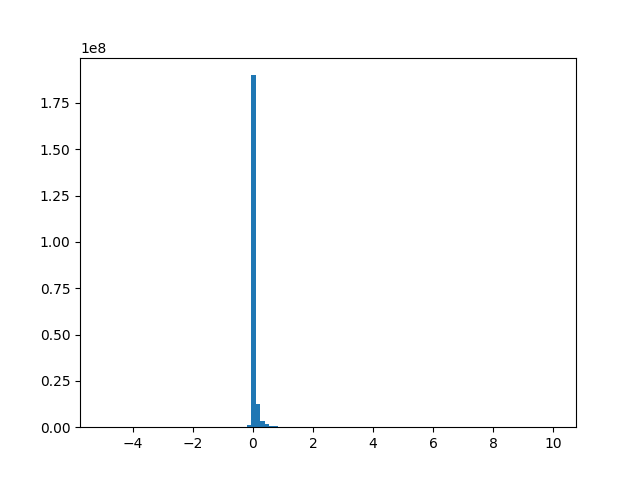

In [8]:
#check distribution of values in T between -5 and 10
plt.figure()
plt.hist(T.flatten(), bins=100, range=(-5,10))
plt.show()


In [9]:
# -- delete unused variables
#del slcHH, slcHV, slcVV
#del pauli1, pauli2, pauli3

## Eigenvalues

In [10]:
lambda1, lambda2, lambda3 = calculate_eigenvalues_3(T11, T12, T13, T22, T23, T33)

/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:64: RuntimeWarning: divide by zero encountered in divide
  LA = ( 1/3.*TR + 2**(1/3.)*B/(3*Z**(1/3.)) + Z**(1/3.)/(3*2**(1/3.)) )
/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:64: RuntimeWarning: invalid value encountered in divide
  LA = ( 1/3.*TR + 2**(1/3.)*B/(3*Z**(1/3.)) + Z**(1/3.)/(3*2**(1/3.)) )
/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:65: RuntimeWarning: divide by zero encountered in divide
  LB = ( 1/3.*TR - (1+1j*np.sqrt(3))*B/(3*2**(2/3.)*Z**(1/3.)) - (1-1j*np.sqrt(3))*Z**(1/3.)/(6*2**(1/3.)) )
/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:65: RuntimeWarning: invalid value encountered in divide
  LB = ( 1/3.*TR - (1+1j*np.sqrt(3))*B/(3*2**(2/3.)*Z**(1/3.)) - (1-1j*np.sqrt(3))*Z**(1/3.)/(6*2**(1/3.)) )
/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:66: RuntimeWarning: divide by zero encountered in divide
  LC = ( 1/3.*TR - (1-1j*np.sqrt(3))*B/(3*2**(2/3.)*Z**(1/

In [11]:
# check shape
lambda1.shape

(5200, 4500)

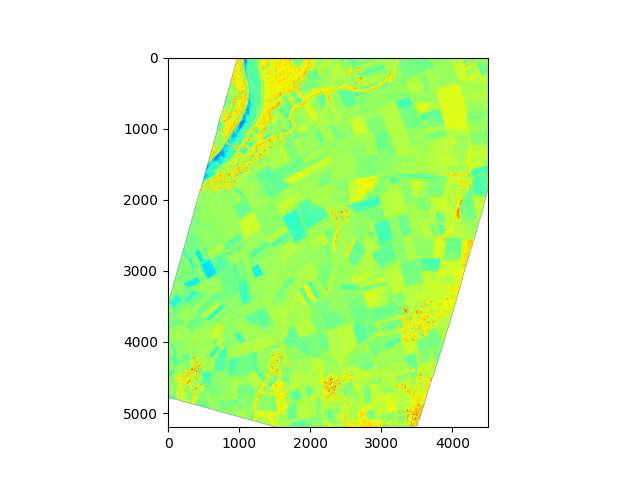

In [12]:
#visualise lambda1
plt.figure()
plt.imshow(10*np.log10(lambda1), cmap='jet')

/var/folders/g7/2783kfj16zj6nhq_m66yk50m0000gp/T/ipykernel_33665/909039049.py:3: RuntimeWarning: divide by zero encountered in log10
  plt.imshow(10*np.log10(lambda3), cmap='jet')
/var/folders/g7/2783kfj16zj6nhq_m66yk50m0000gp/T/ipykernel_33665/909039049.py:3: RuntimeWarning: invalid value encountered in log10
  plt.imshow(10*np.log10(lambda3), cmap='jet')


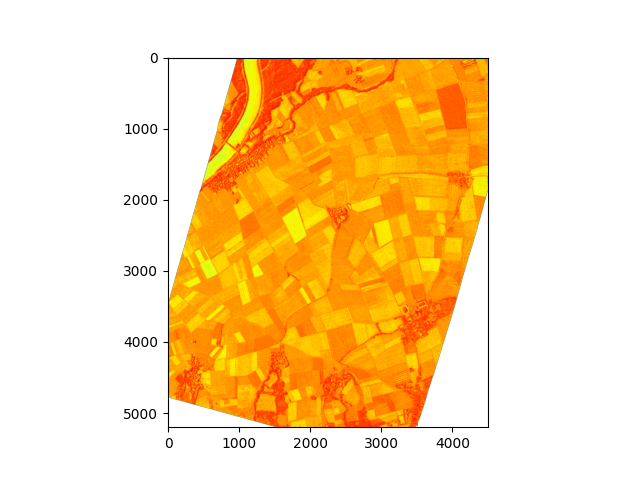

In [13]:
#visualise lambda1
plt.figure()
plt.imshow(10*np.log10(lambda3), cmap='jet')

## Entropy

In [14]:
# -- compute the probabilities associated with each eigenvalue
pr1 = lambda1 / (lambda1 + lambda2 + lambda3)
pr2 = lambda2 / (lambda1 + lambda2 + lambda3)
pr3 = lambda3 / (lambda1 + lambda2 + lambda3)

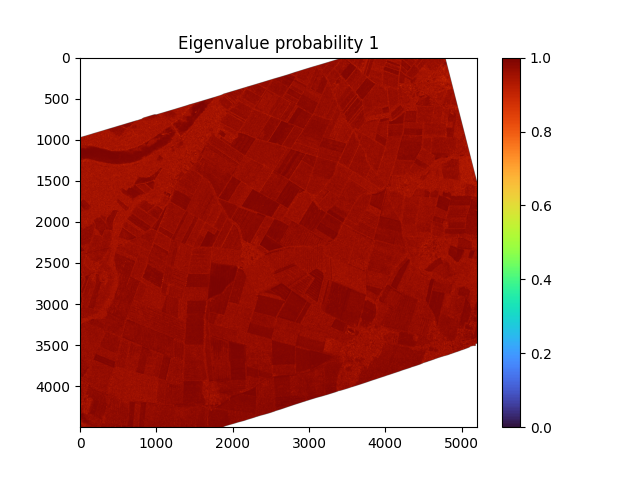

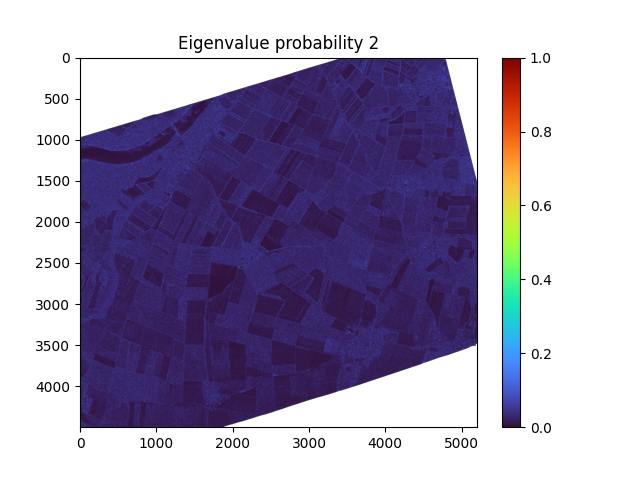

In [15]:
# Plotting eigenvalue probability
plt.figure()
plt.imshow(np.transpose(pr1), cmap='turbo', vmin=0, vmax=1, aspect='auto')
plt.colorbar()
plt.title('Eigenvalue probability 1')
plt.show()

plt.figure()
plt.imshow(np.transpose(pr2), cmap='turbo', vmin=0, vmax=1, aspect='auto')
plt.colorbar()
plt.title('Eigenvalue probability 2')
plt.show()

In [16]:
# -- compute the entropy
entropy = -(pr1 * np.log10(pr1)/np.log10(3) + pr2 * np.log10(pr2)/np.log10(3) + pr3 * np.log10(pr3)/np.log10(3))

/var/folders/g7/2783kfj16zj6nhq_m66yk50m0000gp/T/ipykernel_33665/1129017461.py:2: RuntimeWarning: divide by zero encountered in log10
  entropy = -(pr1 * np.log10(pr1)/np.log10(3) + pr2 * np.log10(pr2)/np.log10(3) + pr3 * np.log10(pr3)/np.log10(3))
/var/folders/g7/2783kfj16zj6nhq_m66yk50m0000gp/T/ipykernel_33665/1129017461.py:2: RuntimeWarning: invalid value encountered in log10
  entropy = -(pr1 * np.log10(pr1)/np.log10(3) + pr2 * np.log10(pr2)/np.log10(3) + pr3 * np.log10(pr3)/np.log10(3))
/var/folders/g7/2783kfj16zj6nhq_m66yk50m0000gp/T/ipykernel_33665/1129017461.py:2: RuntimeWarning: invalid value encountered in multiply
  entropy = -(pr1 * np.log10(pr1)/np.log10(3) + pr2 * np.log10(pr2)/np.log10(3) + pr3 * np.log10(pr3)/np.log10(3))


## Anisotropy

In [17]:
# -- compute the anisotropy (related to the minimum and intermediate eigenvalues)
# A = 0 when lambda2 = lambda3
# A = 1 when lambda2 >> lambda3
anisotropy =  (lambda2 - lambda3) / (lambda2 + lambda3)

/var/folders/g7/2783kfj16zj6nhq_m66yk50m0000gp/T/ipykernel_33665/1366790859.py:4: RuntimeWarning: divide by zero encountered in divide
  anisotropy =  (lambda2 - lambda3) / (lambda2 + lambda3)
/var/folders/g7/2783kfj16zj6nhq_m66yk50m0000gp/T/ipykernel_33665/1366790859.py:4: RuntimeWarning: invalid value encountered in divide
  anisotropy =  (lambda2 - lambda3) / (lambda2 + lambda3)


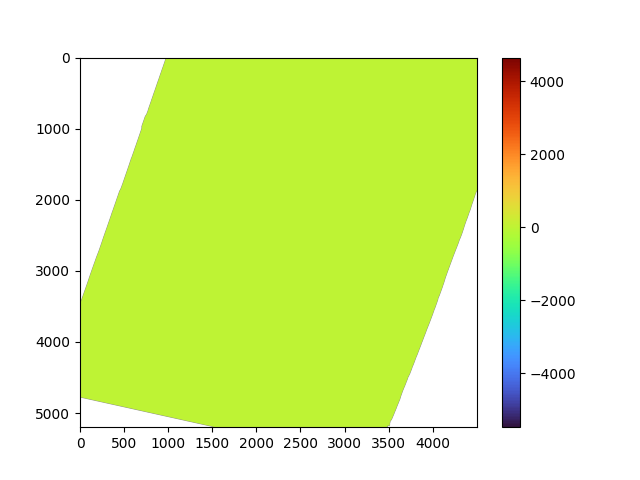

In [18]:
#visualise anisotropy
plt.figure()
plt.imshow(anisotropy, cmap='turbo', aspect='auto')
plt.colorbar()


## Eigenvectors

In [19]:
# -- compute the eigenvectors
U1, U2, U3 = calculate_eigenvectors_3(T11, T12, T13, T22, T23, T33, lambda1, lambda2, lambda3)

/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:97: RuntimeWarning: invalid value encountered in divide
  U1[:, :, 0] = (L1 -T33)/np.conj(T13) + (((L1-T33)*np.conj(T12) + np.conj(T13)*T23)*np.conj(T23))/ \
/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:97: RuntimeWarning: invalid value encountered in multiply
  U1[:, :, 0] = (L1 -T33)/np.conj(T13) + (((L1-T33)*np.conj(T12) + np.conj(T13)*T23)*np.conj(T23))/ \
/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:98: RuntimeWarning: invalid value encountered in multiply
  (((T22-L1)*np.conj(T13) - np.conj(T12)*np.conj(T23))*np.conj(T13))
/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:99: RuntimeWarning: invalid value encountered in multiply
  U1[:, :, 1] = -((L1-T33)*np.conj(T12)+np.conj(T13)*T23) / ((T22-L1)*np.conj(T13) - np.conj(T12)*np.conj(T23))
/Volumes/dugue/PhD_SAR4AGRI/14CROPEX/PolINSAR_utilities.py:99: RuntimeWarning: invalid value encountered in divide
  U1[:, :, 1] = -((L1-T33)*np.conj

In [20]:
# check shape
U1.shape

(5200, 4500, 3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..3.1415925].


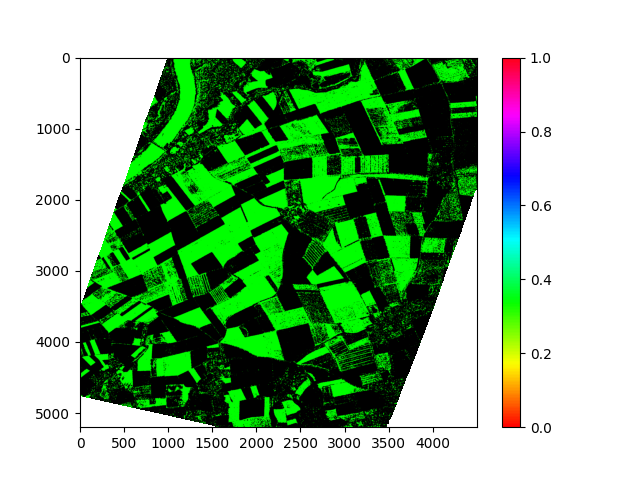

In [21]:
#visualise eigenvecotrs
plt.figure()
plt.imshow(np.angle(U1), cmap='hsv', aspect='auto')
plt.colorbar()


In [22]:
# -- delete unused variables
#del T12, T13, T23

## Mean alpha angle

In [23]:
# -- extract the alpha angles
alpha1 = np.arccos(np.abs(U1[:,:,0]))  # [rad]
alpha2 = np.arccos(np.abs(U2[:,:,0]))
alpha3 = np.arccos(np.abs(U3[:,:,0]))

In [24]:
# -- delete unused variables
#del U1, U2, U3

In [25]:
# -- compute the mean alpha angle
alpha_mean = pr1*alpha1 + pr2*alpha2 + pr3*alpha3
# -- transfer to degrees
alpha_mean = np.degrees(alpha_mean)

In [26]:
alpha_mean

array([[      nan,       nan,       nan, ..., 24.06091 , 23.484613,
        22.930971],
       [      nan,       nan,       nan, ..., 23.095354, 22.69366 ,
        22.36914 ],
       [      nan,       nan,       nan, ..., 23.333145, 23.175316,
        23.066877],
       ...,
       [      nan,       nan,       nan, ...,       nan,       nan,
              nan],
       [      nan,       nan,       nan, ...,       nan,       nan,
              nan],
       [      nan,       nan,       nan, ...,       nan,       nan,
              nan]], shape=(5200, 4500), dtype=float32)

## Plotting

In [27]:
# Calculations for Paulis RGB:
# -- define the 3D array for the Pauli representation
dimaz = T11.shape[0]
dimrg = T11.shape[1]
rgb_pauli = np.zeros((dimrg, dimaz,3), 'float32')

# -- fill the array, clipping the values between 0 and 2.5xmean(amplitude)
rgb_pauli[:,:,0] =np.clip(np.transpose(np.sqrt(abs(T22))), 0, 2.5*np.mean(np.sqrt(abs(T22)))) # R: HH-VV
rgb_pauli[:,:,1] =np.clip(np.transpose(np.sqrt(abs(T33))), 0, 2.5*np.mean(np.sqrt(abs(T33)))) # G: HV
rgb_pauli[:,:,2] =np.clip(np.transpose(np.sqrt(abs(T11))), 0, 2.5*np.mean(np.sqrt(abs(T11)))) # B: HH+VV

# -- normalisation: values between 0 and 1
rgb_pauli[:,:,0] = rgb_pauli[:,:,0] / np.max(rgb_pauli[:,:,0])
rgb_pauli[:,:,1] = rgb_pauli[:,:,1] / np.max(rgb_pauli[:,:,1])
rgb_pauli[:,:,2] = rgb_pauli[:,:,2] / np.max(rgb_pauli[:,:,2])

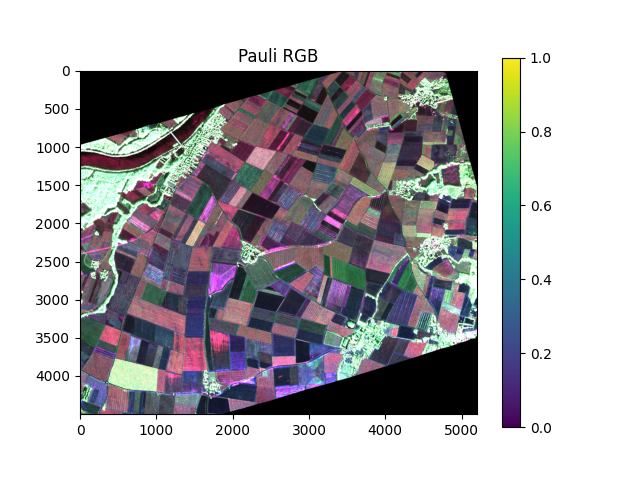

In [28]:
# Plot: Pauli RGB
plt.figure()
plt.imshow(rgb_pauli)
plt.title('Pauli RGB')
plt.colorbar()
plt.show()

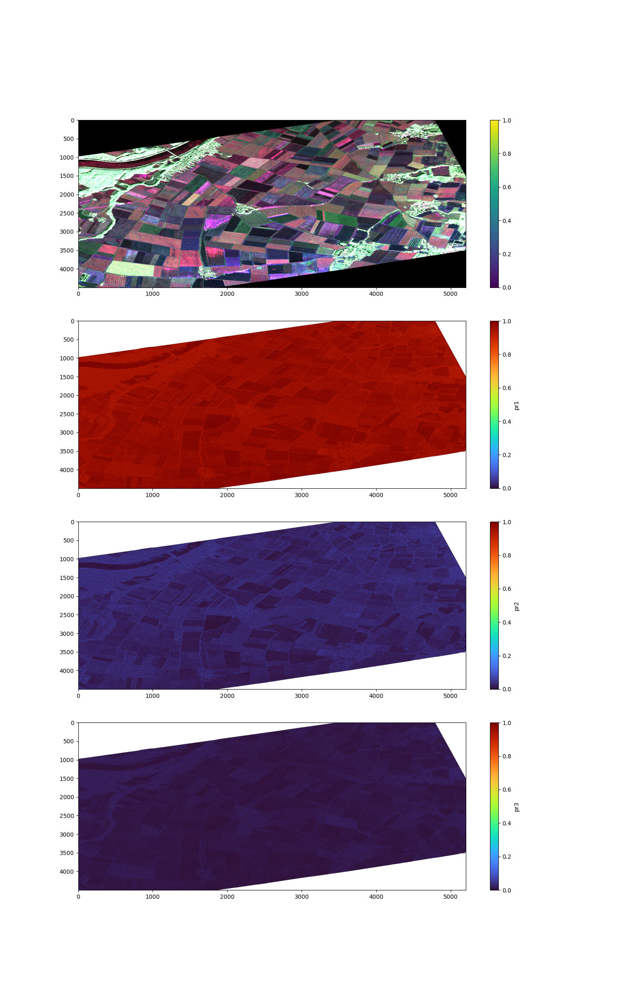

In [29]:
# Plot: Pauli RGB and eigenvalue probabilities
plt.figure(figsize=(15, 6*4))
plt.subplot(4,1,1)
plt.imshow(rgb_pauli, aspect='auto')
plt.colorbar()

plt.subplot(4,1,2)
plt.imshow(np.transpose(pr1), cmap='turbo', vmin=0, vmax=1, aspect='auto')
cb = plt.colorbar()
cb.set_label('pr1')

plt.subplot(4,1,3)
plt.imshow(np.transpose(pr2), cmap='turbo', vmin=0, vmax=1, aspect='auto')
cb = plt.colorbar()
cb.set_label('pr2')

plt.subplot(4,1,4)
plt.imshow(np.transpose(pr3), cmap='turbo', vmin=0, vmax=1, aspect='auto')
cb = plt.colorbar()
cb.set_label('pr3')

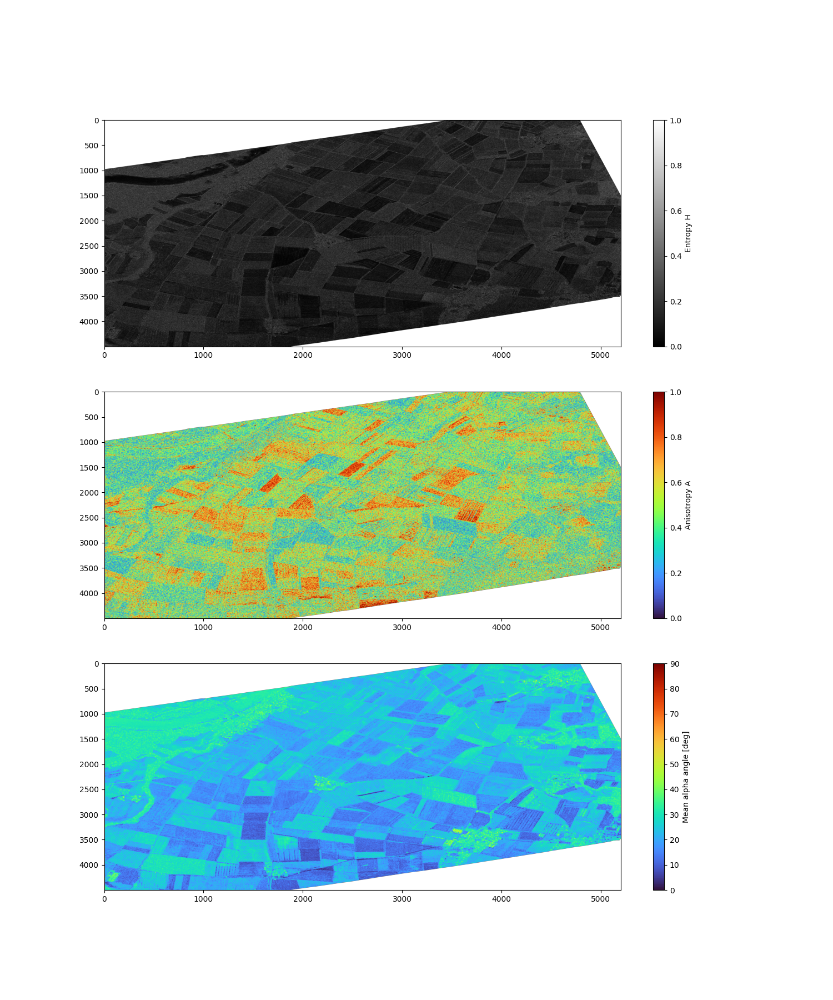

In [30]:
# Plot: H, A, alpha
plt.figure(figsize=(15, 6*3))

plt.subplot(3,1,1)
plt.imshow(np.transpose(entropy), cmap='gray', vmin=0, vmax=1, aspect='auto')
cb = plt.colorbar()
cb.set_label('Entropy H')

plt.subplot(3,1,2)
plt.imshow(np.transpose(anisotropy), cmap='turbo', vmin=0, vmax=1, aspect='auto')
cb = plt.colorbar()
cb.set_label('Anisotropy A')

plt.subplot(3,1,3)
plt.imshow(np.transpose(alpha_mean), cmap='turbo', vmin=0, vmax=90, aspect='auto')
cb = plt.colorbar()
cb.set_label('Mean alpha angle [deg]')

## HSI Color representation

- H (hue):  mean alpha angle
- S (saturation):
     - Case 1: saturation = 1: always full colorscale
     - Case 2:  saturation = 1 - entropy
          - when entropy = 0: then saturation = 1: full colorscale
          - when entropy = 1: then saturation = 0: grayscale
- I (intensity): amplitude of total power

In [31]:
# Hue: mean alpha angle
# normalize the mean alpha angle: it has to be between 0 and 1 --> divide by 90 degrees
hue = alpha_mean / 90

# Import the colormap for plotting alpha
colormap = plt.colormaps.get('turbo')

# Intensity: normalize the amplitude
amp = np.sqrt(abs(T11) + abs(T22) + abs(T33))
amp = np.clip(amp, 0, 2.5*np.mean(amp))
amp = amp / np.max(amp)

# Saturation
# Case 1)
sat1 = np.ones_like(amp)
# Case 2)
sat2 = 1 - entropy

In [32]:
# Generate the HSV colormaps

# Case 1
rgb_comp1 = HSV_colormap_to_rgb(colormap, hue, sat1, amp)

# Case 2
rgb_comp2 = HSV_colormap_to_rgb(colormap, hue, sat2, amp)

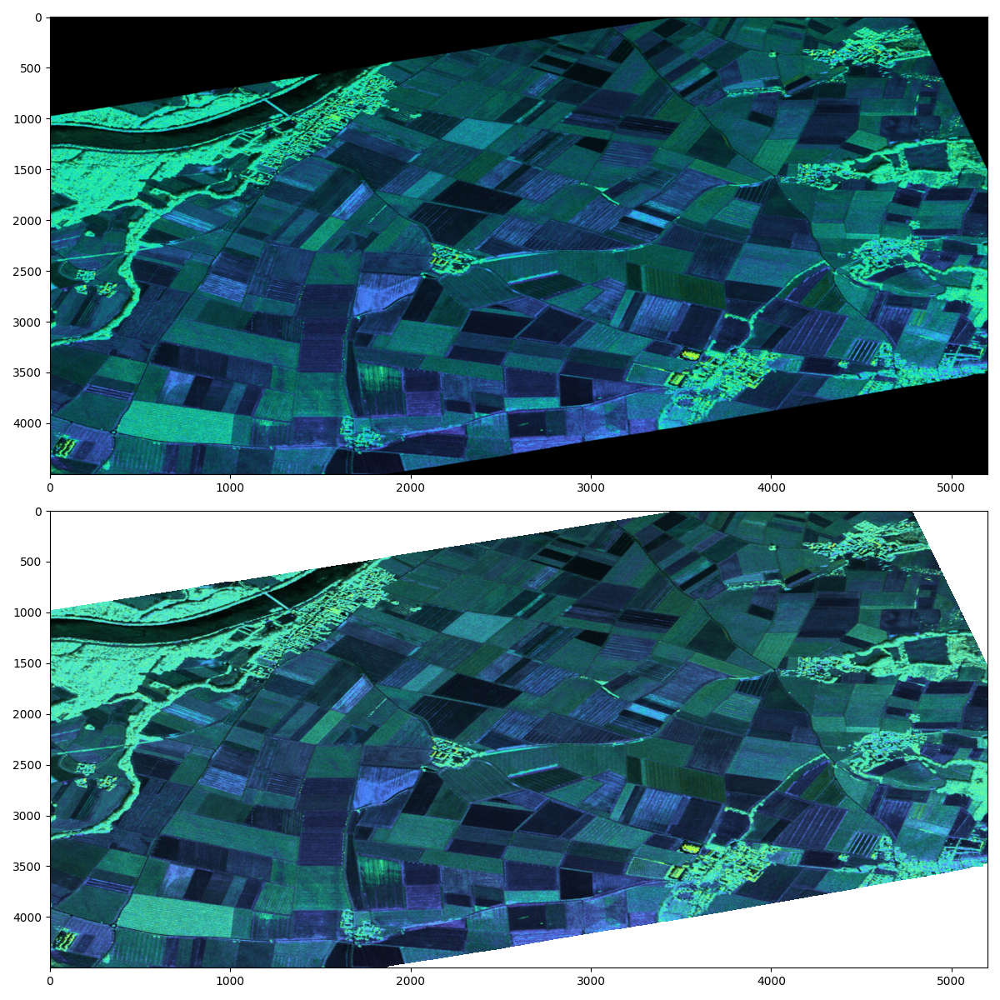

In [33]:
# Plot: HSI representations

plt.figure(figsize=(12,12))

plt.subplot(2,1,1)
plt.imshow(np.transpose(rgb_comp1, axes=(1,0,2)), aspect = 'auto')

plt.subplot(2,1,2)
plt.imshow(np.transpose(rgb_comp2, axes=(1,0,2)), aspect = 'auto')

plt.tight_layout()

# Timeseries analysis

## Getting the acquisition times/days

In [34]:
'''
import os
import re

# Define the root directory of the SAR data
root_dir = "/Volumes/unique/2014-2014_FSAR_Germany(Wallerfing)_14CROPEX_Agriculture"

# Initialize a list to store acquisition dates
acquisition_dates = []

# Regular expression to identify and extract dates (modify based on folder naming patterns)
date_pattern = re.compile(r"T\d+_(\d{2})(\d{2})_\d{4}[CL]")

# Walk through the folder structure
for root, dirs, files in os.walk(root_dir):
    for dir_name in dirs:
        match = date_pattern.search(dir_name)
        if match:
            # Extract day and month from the folder name
            day, month = match.groups()
            # Format the date (assuming year is not included in the folder name)
            date = f"{day}-{month}"
            acquisition_dates.append(date)

# Remove duplicates and sort dates
acquisition_dates = sorted(set(acquisition_dates))

# Print the acquisition dates
print("Dates of acquisition:")
for date in acquisition_dates:
    print(date)

    '''

<>:1: SyntaxWarning: invalid escape sequence '\d'
<>:1: SyntaxWarning: invalid escape sequence '\d'
/var/folders/g7/2783kfj16zj6nhq_m66yk50m0000gp/T/ipykernel_33665/3583757969.py:1: SyntaxWarning: invalid escape sequence '\d'
  '''


'\nimport os\nimport re\n\n# Define the root directory of the SAR data\nroot_dir = "/Volumes/unique/2014-2014_FSAR_Germany(Wallerfing)_14CROPEX_Agriculture"\n\n# Initialize a list to store acquisition dates\nacquisition_dates = []\n\n# Regular expression to identify and extract dates (modify based on folder naming patterns)\ndate_pattern = re.compile(r"T\\d+_(\\d{2})(\\d{2})_\\d{4}[CL]")\n\n# Walk through the folder structure\nfor root, dirs, files in os.walk(root_dir):\n    for dir_name in dirs:\n        match = date_pattern.search(dir_name)\n        if match:\n            # Extract day and month from the folder name\n            day, month = match.groups()\n            # Format the date (assuming year is not included in the folder name)\n            date = f"{day}-{month}"\n            acquisition_dates.append(date)\n\n# Remove duplicates and sort dates\nacquisition_dates = sorted(set(acquisition_dates))\n\n# Print the acquisition dates\nprint("Dates of acquisition:")\nfor date in ac

Check 
Dates of acquisition:\
07-14 \
08-04